In [5]:
import pandas as pd
import matplotlib.pyplot as plt

data = pd.read_parquet('datasets/safety-SanFrancisco_clean.parquet')

In [6]:
# Top 5 categories
top5Cats = data["category"].value_counts().head(5)

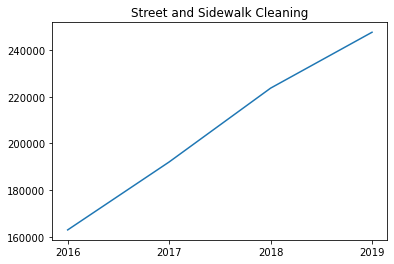

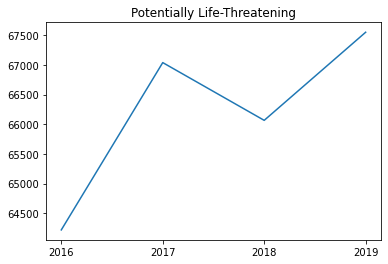

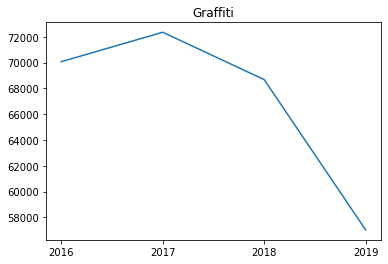

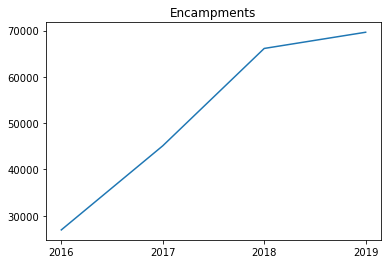

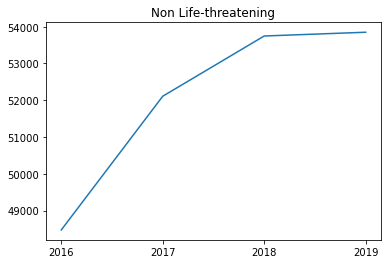

In [5]:
for category in top5Cats.index:
    cat0 = data[data["category"] == category]
    cat0[cat0["dateTime"].dt.year < 2020]['dateTime'].dt.year.value_counts(sort=False).plot(title=category, xticks=[2016,2017,2018,2019])
    plt.show()


In [6]:
import urllib.request
import json
import numpy as np
from matplotlib import path

neighborhoods = {}

def locateHood(lon, lat):
    for k,v in neighborhoods.items():
        if v.contains_point((lon,lat)):
            return k
    return None

def a(row):
    print(row)

sf_link = 'https://gist.githubusercontent.com/rth/403f672baf26beef91285c8079e1d257/raw/ebe3d2a4eda405775a860d251974e1f08cbe4f48/SanFrancisco.Neighborhoods.json'

with urllib.request.urlopen(sf_link) as response:
    sf_json = json.loads(response.read())

for nbh_json in sf_json['features']:
    nbh = nbh_json['properties']['neighborhood']
    if nbh_json['geometry']['geometries'][0]['type'] == 'MultiPolygon':
        points = nbh_json['geometry']['geometries'][0]['coordinates'][0][0]
    else:
        points = nbh_json['geometry']['geometries'][0]['coordinates'][0]
    neighborhoods[nbh] = path.Path(np.array([[e[0], e[1]] for e in points]))

data2 = data[['longitude', 'latitude']]

hoods = []

for index, row in data2.iterrows():
    hoods.append(locateHood(row['longitude'], row['latitude']))

data['hoods'] = hoods

          longitude   latitude
0       -122.422187  37.781286
1       -122.418188  37.791887
2          0.000000   0.000000
3       -122.443245  37.802853
4       -122.456498  37.737953
...             ...        ...
3958884 -122.417755  37.769814
3958885 -122.408529  37.723687
3958886 -122.416391  37.764944
3958887 -122.431373  37.782656
3958888 -122.421558  37.782328

[3221561 rows x 2 columns]
['Tenderloin', 'Nob Hill', None, 'Marina', 'Portola', 'Tenderloin', 'Mission', 'Castro', 'North Beach', 'Sunset', 'Nob Hill', 'Mission', 'Nob Hill', 'Ingleside', 'Sunset', 'South Beach', 'Bayview', 'Nob Hill', 'Inner Richmond', 'Taraval', 'North Beach', 'Tenderloin', 'Nob Hill', 'Sunset', 'SoMa', 'Mission', 'Chinatown', 'Mission', 'Castro', 'Financial District', 'South Beach', 'Nob Hill', None, 'Mission', 'Taraval', 'SoMa', 'SoMa', 'SoMa', 'SoMa', 'Ingleside', 'Ingleside', 'Bayview', 'SoMa', None, 'Ingleside', 'Lake Merced', 'SoMa', 'Lake Merced', 'SoMa', 'Ingleside', 'Bayview', 'Ingleside', '

In [9]:
outputFileName = 'datasets/safety-SanFrancisco_hoods.parquet'
data.to_parquet(outputFileName)

In [ ]:
from ipyleaflet import Map, Marker, MarkerCluster
import pandas as pd

center = (37.773972, -122.4194)
m = Map(center=center, zoom=12)

for category in top5Cats.index:
    markers = []
    cat0 = data[data["category"] == category]
    mask = (cat0['dateTime'] > '2019-01-01 00:00:00') & (cat0['dateTime'] <= '2019-02-01 23:59:59')
    data2 = cat0.loc[mask]
    data2 = data2[['longitude', 'latitude', 'category']]
    
    for index, row in data2.iterrows():
        mcenter = (row['latitude'], row['longitude'])
        marker = Marker(location=mcenter, draggable=False, title=category)
        markers.append(marker)
        
    allm = tuple(markers)
    mcluster = MarkerCluster(markers = allm)
    m.add_layer(mcluster)

display(m)
